In [412]:
# Loading the cleaned dataset
import pandas as pd

file_path = '/Users/mac/Desktop/Computing Innovation Project/Melbourne_DataSet/official_clean_data.csv'
sales_data_clean = pd.read_csv(file_path)

In [413]:
# Desricption of Data
sales_data_clean.describe()

,Rooms,Distance from CBD,Postcode,Bedroom2,Bathroom,Lattitude,Longtitude,Propertycount,Landsize_winsorized,Price_winsorized,PricePerSquareMeter,Average_Criminial_Incidents_Rate,Average_Victimisation_Rate
count,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,1.334200e+04,13342.000000,10839.000000,10839.000000
mean,2.948583,10.175274,3105.084395,2.924974,1.533803,-37.809108,144.995322,7451.500525,504.456378,1.071940e+06,3107.326797,6692.022613,4135.769928
std,0.951044,5.784989,90.044317,0.961593,0.691769,0.079233,0.103739,4378.388637,257.027177,5.948726e+05,9427.547340,3183.409904,1628.476384
min,1.000000,0.000000,3000.000000,0.000000,0.000000,-38.168020,144.431810,389.000000,77.000000,3.000000e+05,115.230000,3024.850000,1818.500000
25%,2.000000,6.200000,3044.000000,2.000000,1.000000,-37.857160,144.929200,4380.000000,301.000000,6.500000e+05,1237.737500,3849.900000,2716.150000
50%,3.000000,9.300000,3084.000000,3.000000,1.000000,-37.802110,145.000500,6567.000000,533.000000,9.100000e+05,2102.795000,5995.500000,3905.850000
75%,4.000000,13.000000,3148.000000,3.000000,2.000000,-37.755693,145.058675,10331.000000,646.750000,1.335000e+06,3666.670000,8049.250000,5028.700000
max,10.000000,47.400000,3977.000000,20.000000,8.000000,-37.408530,145.526350,21650.000000,2000.000000,3.350000e+06,710000.000000,17805.250000,8643.400000


In [414]:
# Distribution of categorical feature of Type
sales_data_clean['Type'].value_counts()

Type
house        9399
unit         2841
townhouse    1102
Name: count, dtype: int64

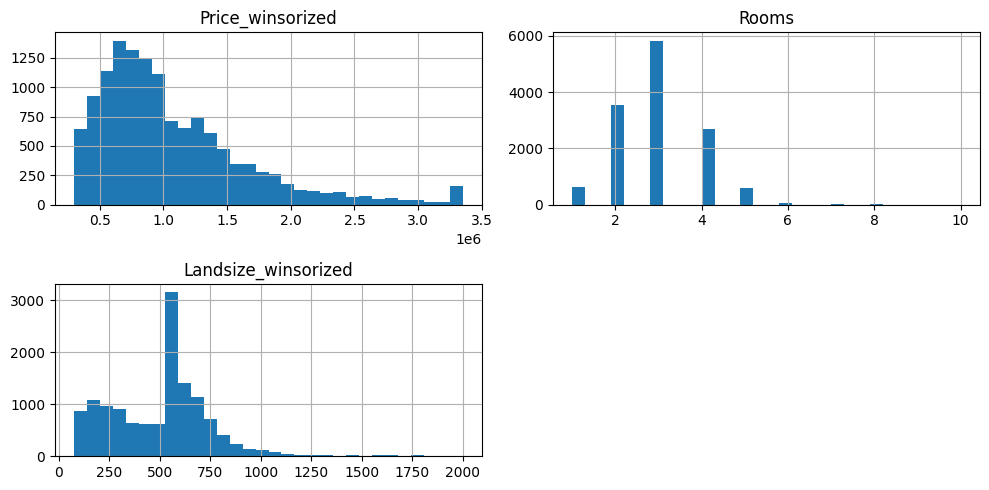

In [415]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot histograms for Price, Rooms, and Landsize
sales_data_clean[['Price_winsorized', 'Rooms', 'Landsize_winsorized']].hist(bins=30, figsize=(10, 5))
plt.tight_layout()
plt.show()


Total number of rows: 13342


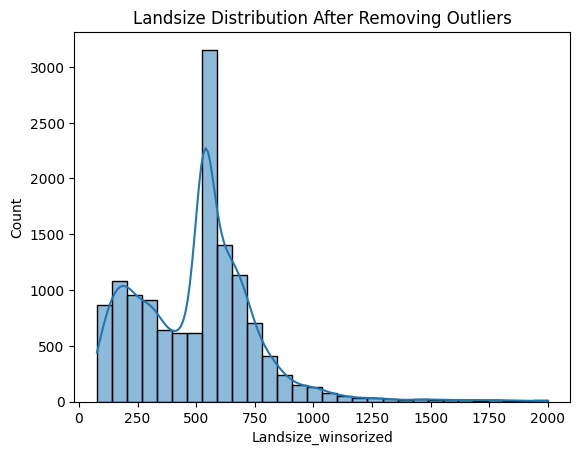

In [416]:

row_count = len(sales_data_clean)
print(f'Total number of rows: {row_count}')

# Plot the distribution of land sizes after removing outliers
sns.histplot(sales_data_clean['Landsize_winsorized'], bins=30, kde=True)
plt.title('Landsize Distribution After Removing Outliers')
plt.show()


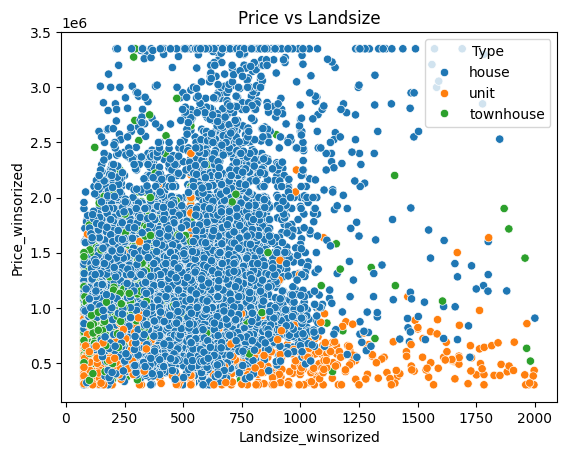

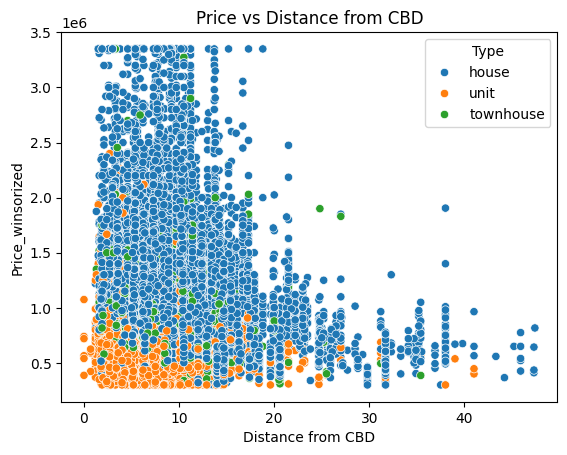

In [417]:
# Scatter plot for Price vs Landsize
sns.scatterplot(x='Landsize_winsorized', y='Price_winsorized', data=sales_data_clean, hue='Type')
plt.title('Price vs Landsize')
plt.show()

# Scatter plot for Price vs Distance from CBD
sns.scatterplot(x='Distance from CBD', y='Price_winsorized', data=sales_data_clean, hue='Type')
plt.title('Price vs Distance from CBD')
plt.show()

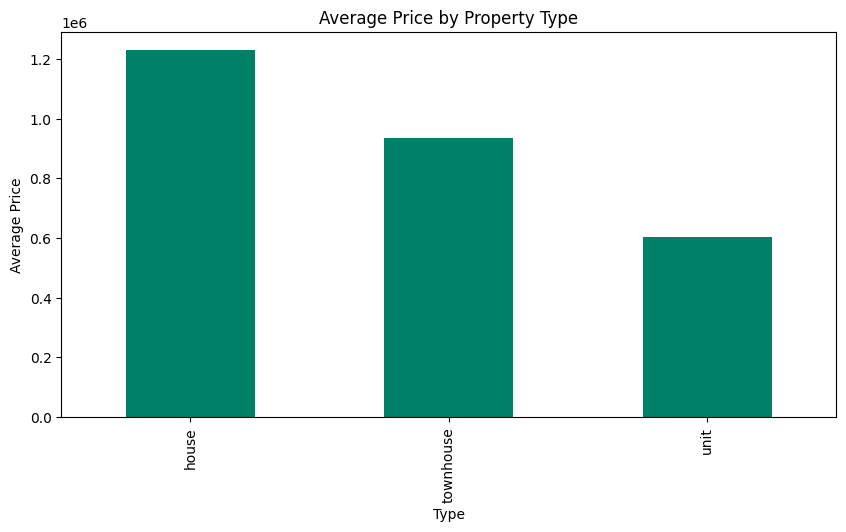

In [418]:
# Bar plot for average price by property Type
sales_data_clean.groupby('Type')['Price_winsorized'].mean().plot(kind='bar', figsize=(10, 5), colormap='summer')
plt.title('Average Price by Property Type')
plt.ylabel('Average Price')
plt.show()


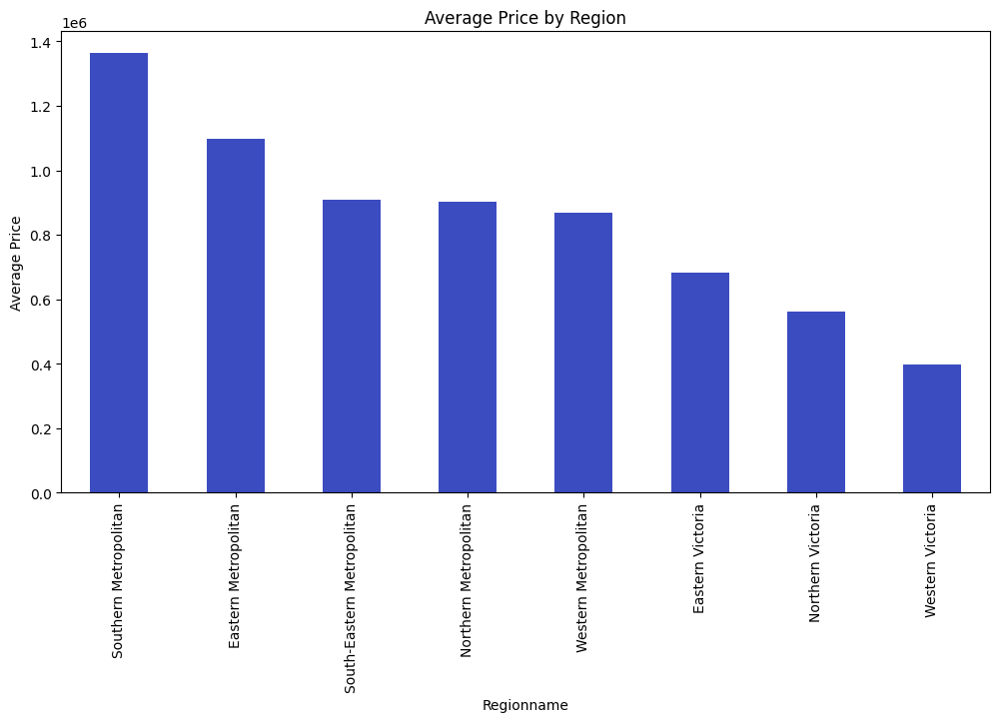

In [419]:
# Bar plot for average price by Region
sales_data_clean.groupby('Regionname')['Price_winsorized'].mean().sort_values(ascending=False).plot(kind='bar', figsize=(12, 6), colormap='coolwarm')
plt.title('Average Price by Region')
plt.ylabel('Average Price')
plt.show()


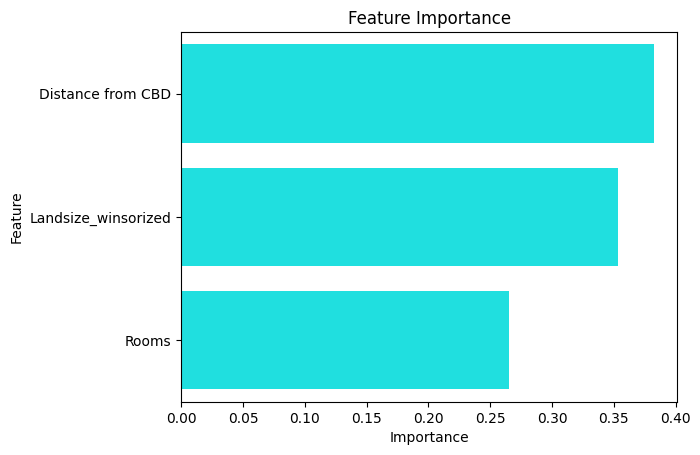

In [420]:
# RandomForestRegressor Model used to find the most important facture that influence price

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

X = sales_data_clean[['Rooms', 'Landsize_winsorized', 'Distance from CBD']] 
y = sales_data_clean['Price_winsorized']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

importances = model.feature_importances_

feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': importances}).sort_values(by='Importance', ascending=False)

sns.barplot(x='Importance', y='Feature', data=feature_importance_df, color='cyan')
plt.title('Feature Importance')
plt.show()


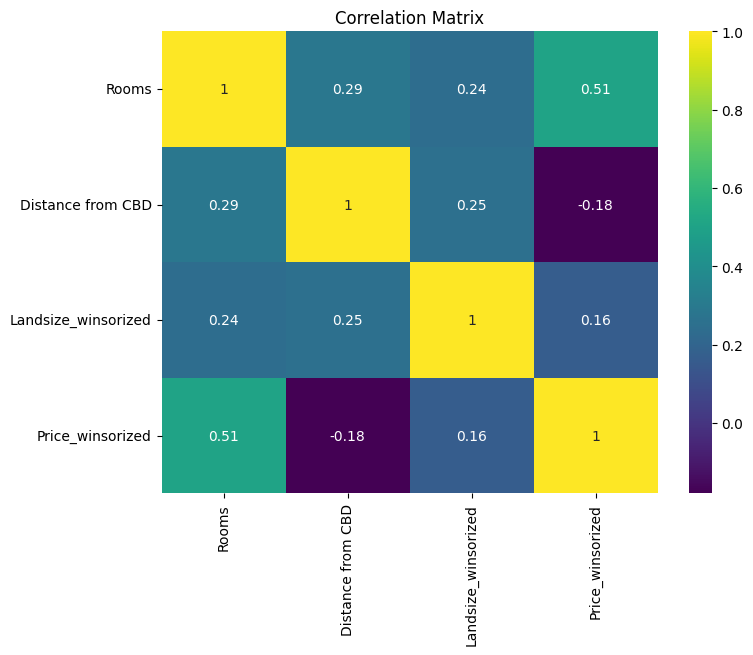

In [421]:
# This is a heatmap for Rooms, Distance from CBD, Landsize_winsorized and Price_winsorized

import seaborn as sns


correlation_matrix = sales_data_clean[['Rooms', 'Distance from CBD', 'Landsize_winsorized', 'Price_winsorized']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis')
plt.title('Correlation Matrix')
plt.show()


In [422]:
# A map that display the property location and values ranging depend on price

import folium

map_center = [sales_data_clean['Lattitude'].mean(), sales_data_clean['Longtitude'].mean()]
property_map = folium.Map(location=map_center, zoom_start=11)

def color_producer(price):
    if price < 1000000:
        return 'green'
    elif 1000000 <= price < 2000000:
        return 'orange'
    else:
        return 'red'

# Add property detail to the map
for i, row in sales_data_clean.iterrows():
    folium.CircleMarker(
        location=[row['Lattitude'], row['Longtitude']],
        radius=5,
        popup=f"Price: {row['Price_winsorized']}, Suburb: {row['Suburb']}",
        color=color_producer(row['Price_winsorized']),
        fill=True,
        fill_color=color_producer(row['Price_winsorized'])
    ).add_to(property_map)

# Display the map
property_map


In [423]:
sales_data_clean.describe()

,Rooms,Distance from CBD,Postcode,Bedroom2,Bathroom,Lattitude,Longtitude,Propertycount,Landsize_winsorized,Price_winsorized,PricePerSquareMeter,Average_Criminial_Incidents_Rate,Average_Victimisation_Rate
count,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,13342.000000,1.334200e+04,13342.000000,10839.000000,10839.000000
mean,2.948583,10.175274,3105.084395,2.924974,1.533803,-37.809108,144.995322,7451.500525,504.456378,1.071940e+06,3107.326797,6692.022613,4135.769928
std,0.951044,5.784989,90.044317,0.961593,0.691769,0.079233,0.103739,4378.388637,257.027177,5.948726e+05,9427.547340,3183.409904,1628.476384
min,1.000000,0.000000,3000.000000,0.000000,0.000000,-38.168020,144.431810,389.000000,77.000000,3.000000e+05,115.230000,3024.850000,1818.500000
25%,2.000000,6.200000,3044.000000,2.000000,1.000000,-37.857160,144.929200,4380.000000,301.000000,6.500000e+05,1237.737500,3849.900000,2716.150000
50%,3.000000,9.300000,3084.000000,3.000000,1.000000,-37.802110,145.000500,6567.000000,533.000000,9.100000e+05,2102.795000,5995.500000,3905.850000
75%,4.000000,13.000000,3148.000000,3.000000,2.000000,-37.755693,145.058675,10331.000000,646.750000,1.335000e+06,3666.670000,8049.250000,5028.700000
max,10.000000,47.400000,3977.000000,20.000000,8.000000,-37.408530,145.526350,21650.000000,2000.000000,3.350000e+06,710000.000000,17805.250000,8643.400000


In [424]:
print(sales_data_clean.columns)


Index(['Suburb', 'Address', 'Rooms', 'Type', 'Method', 'Date',
       'Distance from CBD', 'Postcode', 'Bedroom2', 'Bathroom', 'CouncilArea',
       'Lattitude', 'Longtitude', 'Regionname', 'Propertycount',
       'Landsize_winsorized', 'Price_winsorized', 'PricePerSquareMeter',
       'Average_Criminial_Incidents_Rate', 'Average_Victimisation_Rate'],
      dtype='object')


In [425]:
# Sorting the value of Top 10 of lowest and highest average house rate

region_grouped = sales_data_clean.groupby('CouncilArea').agg({
    'Price_winsorized': 'mean',
    'Average_Criminial_Incidents_Rate': 'mean'
}).reset_index()

top_10_highest_price = region_grouped.sort_values(by='Price_winsorized', ascending=False).head(10)
top_10_lowest_price = region_grouped.sort_values(by='Price_winsorized', ascending=True).head(10)

print("Top 10 CouncilAreas with Highest Average House Rate:")
print(top_10_highest_price)

print("\nTop 10 CouncilAreas with Lowest Average House Price:")
print(top_10_lowest_price)



Top 10 CouncilAreas with Highest Average House Rate:
     CouncilArea  Price_winsorized  Average_Criminial_Incidents_Rate
1        bayside      1.636460e+06                           3849.90
2     boroondara      1.624411e+06                           3695.95
27   unavailable      1.325000e+06                               NaN
26   stonnington      1.268575e+06                           7685.45
15    manningham      1.222508e+06                           3024.85
29    whitehorse      1.221592e+06                           3638.60
28       unknown      1.175440e+06                               NaN
32         yarra      1.151485e+06                          11571.00
20        monash      1.151322e+06                           4351.15
25  port phillip      1.142265e+06                           9309.55

Top 10 CouncilAreas with Lowest Average House Price:
       CouncilArea  Price_winsorized  Average_Criminial_Incidents_Rate
22       moorabool     300000.000000                           

/var/folders/lp/93nzx6zn4qq3tmg26cwcn91w0000gn/T/ipykernel_8793/3208326019.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='CouncilArea', y='Price_winsorized', data=top_10_highest_price, palette='viridis', ax=axes[0])
/var/folders/lp/93nzx6zn4qq3tmg26cwcn91w0000gn/T/ipykernel_8793/3208326019.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='CouncilArea', y='Price_winsorized', data=top_10_lowest_price, palette='coolwarm', ax=axes[1])


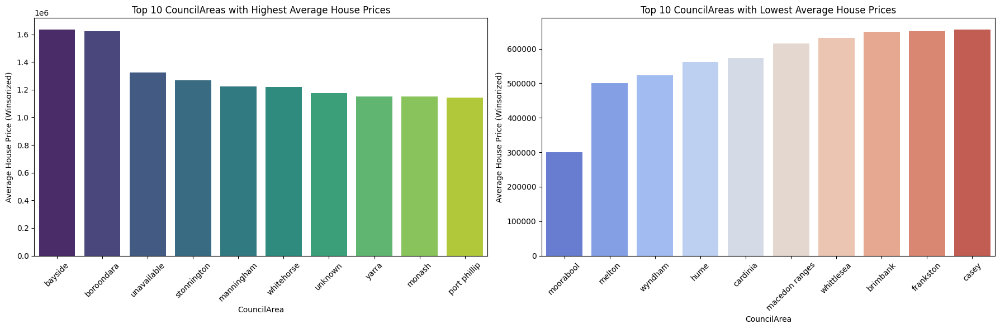

/var/folders/lp/93nzx6zn4qq3tmg26cwcn91w0000gn/T/ipykernel_8793/3208326019.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='CouncilArea', y='Average_Criminial_Incidents_Rate', data=top_10_highest_price, palette='viridis', ax=axes[0])
/var/folders/lp/93nzx6zn4qq3tmg26cwcn91w0000gn/T/ipykernel_8793/3208326019.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='CouncilArea', y='Average_Criminial_Incidents_Rate', data=top_10_lowest_price, palette='coolwarm', ax=axes[1])


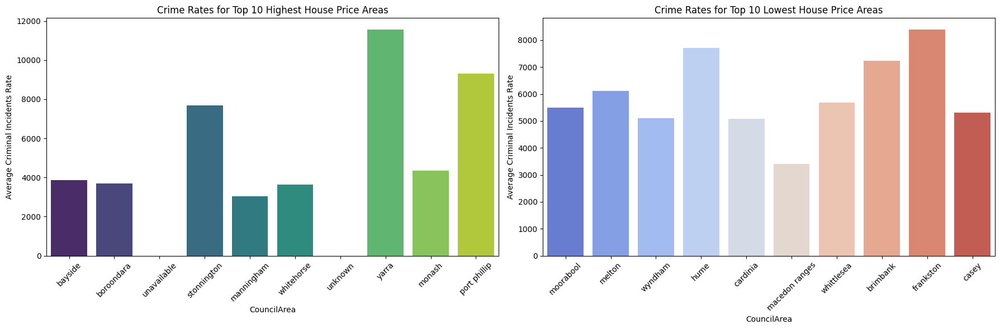

In [426]:


# Barplot of Top 10 Highest and Top 10 Lowest House Price Areas
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.barplot(x='CouncilArea', y='Price_winsorized', data=top_10_highest_price, palette='viridis', ax=axes[0])
axes[0].set_title('Top 10 CouncilAreas with Highest Average House Prices')
axes[0].set_xlabel('CouncilArea')
axes[0].set_ylabel('Average House Price (Winsorized)')
axes[0].tick_params(axis='x', rotation=45)

sns.barplot(x='CouncilArea', y='Price_winsorized', data=top_10_lowest_price, palette='coolwarm', ax=axes[1])
axes[1].set_title('Top 10 CouncilAreas with Lowest Average House Prices')
axes[1].set_xlabel('CouncilArea')
axes[1].set_ylabel('Average House Price (Winsorized)')
axes[1].tick_params(axis='x', rotation=45)
plt.tight_layout()
plt.show()

# Barplot of Crime Rate for Top 10 Highest and Top 10 Lowest House Price Council Area

fig, axes = plt.subplots(1, 2, figsize=(18, 6))
sns.barplot(x='CouncilArea', y='Average_Criminial_Incidents_Rate', data=top_10_highest_price, palette='viridis', ax=axes[0])
axes[0].set_title('Crime Rates for Top 10 Highest House Price Areas')
axes[0].set_xlabel('CouncilArea')
axes[0].set_ylabel('Average Criminal Incidents Rate')
axes[0].tick_params(axis='x', rotation=45)

sns.barplot(x='CouncilArea', y='Average_Criminial_Incidents_Rate', data=top_10_lowest_price, palette='coolwarm', ax=axes[1])
axes[1].set_title('Crime Rates for Top 10 Lowest House Price Areas')
axes[1].set_xlabel('CouncilArea')
axes[1].set_ylabel('Average Criminal Incidents Rate')
axes[1].tick_params(axis='x', rotation=45)
plt.tight_layout()
plt.show()


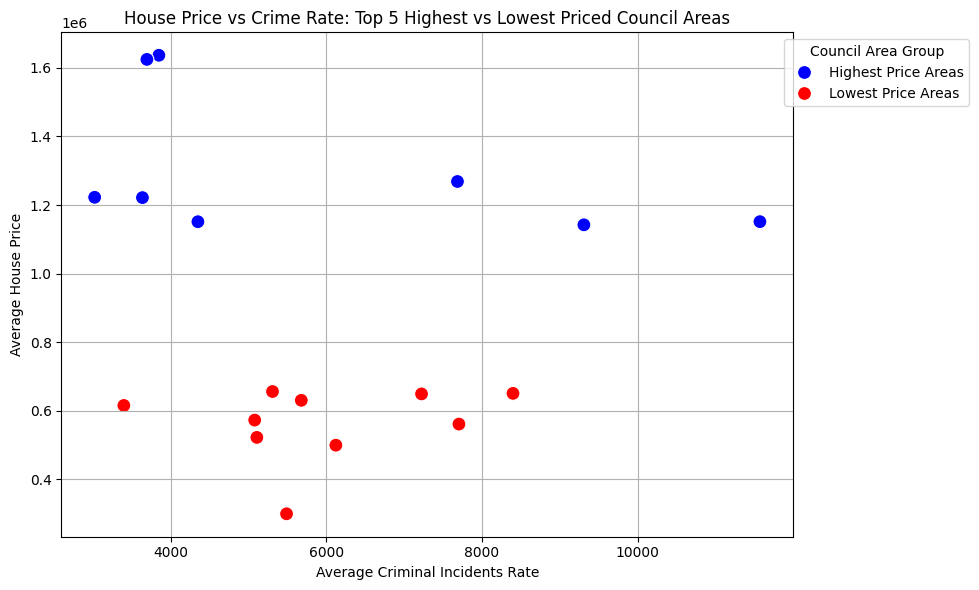

In [427]:
# The scatterplot visualization for the House price and Crime Rate
top_10_highest_price['Group'] = 'Highest Price Areas'
top_10_lowest_price['Group'] = 'Lowest Price Areas'

combined_df = pd.concat([top_10_highest_price, top_10_lowest_price])

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Average_Criminial_Incidents_Rate', y='Price_winsorized', hue='Group', data=combined_df, s=100, palette=['blue', 'red'])

plt.title('House Price vs Crime Rate: Top 5 Highest vs Lowest Priced Council Areas')
plt.xlabel('Average Criminal Incidents Rate')
plt.ylabel('Average House Price')
plt.legend(title='Council Area Group', loc='upper right', bbox_to_anchor=(1.25, 1))
plt.grid(True)

plt.tight_layout()
plt.show()


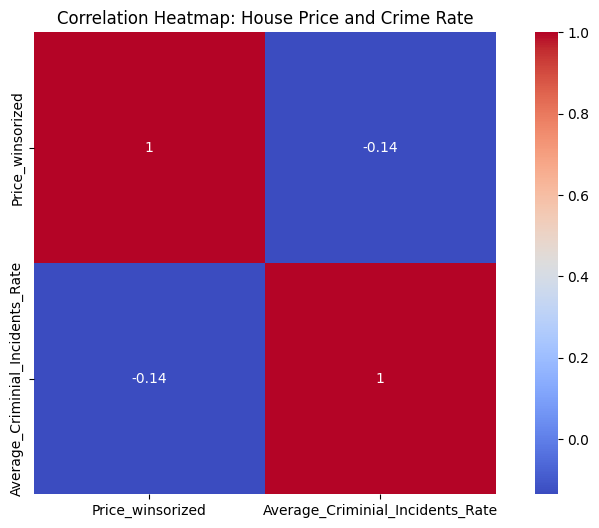

In [428]:
# Heatmap between House Price and Crime Rate
plt.figure(figsize=(10, 6))
corr_matrix = combined_df[['Price_winsorized', 'Average_Criminial_Incidents_Rate']].corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', square=True)
plt.title('Correlation Heatmap: House Price and Crime Rate')
plt.show()
